In [2]:
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf
from scipy import stats

In [3]:
df_main = pd.read_csv('../data/merged_data.csv')

In [4]:
df_main.columns

Index(['Unnamed: 0', 'county_code', 'COUNTY', 'STATEABBREVIATION', 'YEAR',
       'AMAT_fac', 'HIVdiagnoses', 'HIVincidence', 'HIVprevalence', 'MH_fac',
       'Med_AMAT_fac', 'Med_MH_fac', 'Med_SA_fac', 'Med_SMAT_fac',
       'Med_TMAT_fac', 'PLHIV', 'Population', 'SA_fac', 'SMAT_fac', 'TMAT_fac',
       'drugdeathrate', 'drugdeathrate_est', 'drugdeaths', 'mme_percap',
       'partD30dayrxrate', 'pctunins', 'num_SSPs', 'bup_phys', 'drugdep',
       'pctunmetneed', 'nonmedpain', 'ADULTMEN', 'MSM12MTH', 'MSM5YEAR',
       '%msm12month', '%msm5yr', 'unemployment_rate', 'poverty_rate',
       'household_income'],
      dtype='object')

In [5]:
len(df_main)

3140

/home/robin/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/misc.py:89: UserWarning: Attempting to set identical left == right == 2015.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[j])
/home/robin/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/misc.py:90: UserWarning: Attempting to set identical bottom == top == 2015.0 results in singular transformations; automatically expanding.
  ax.set_ylim(boundaries_list[i])
/home/robin/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/misc.py:80: UserWarning: Attempting to set identical left == right == 2015.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[i])


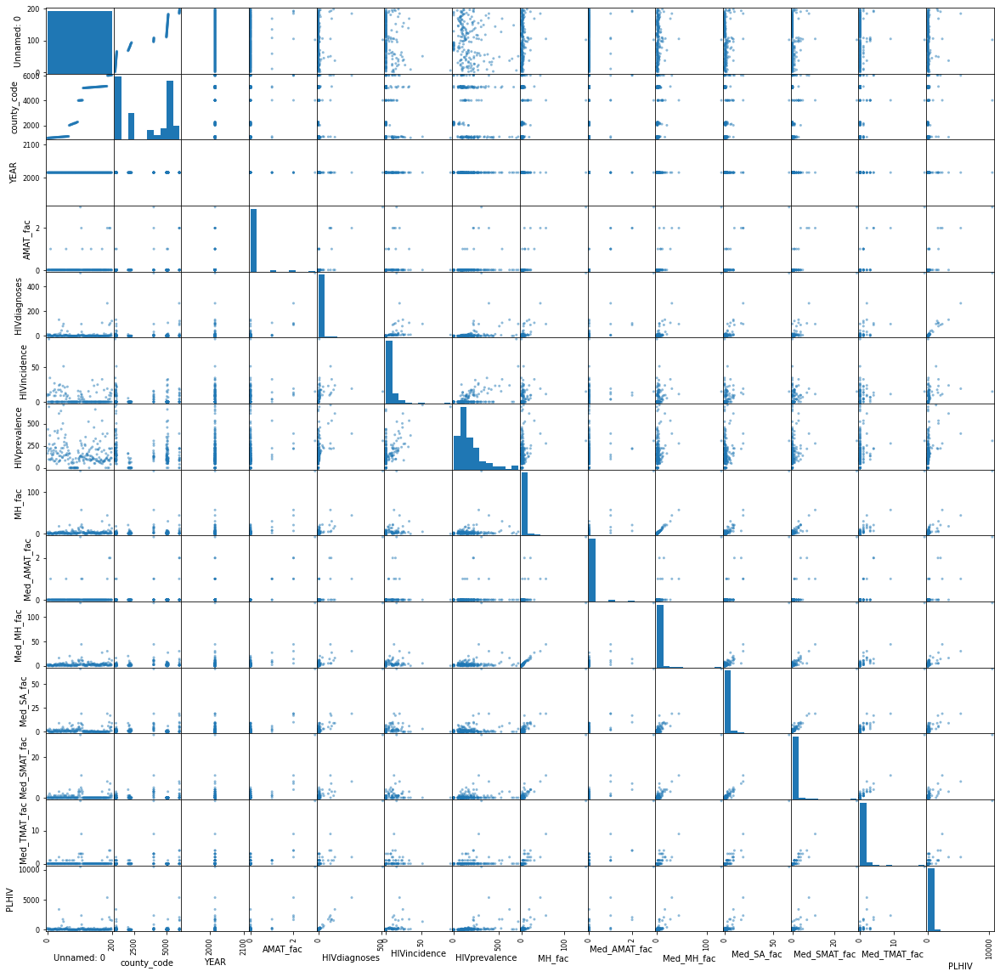

In [6]:
pd.plotting.scatter_matrix(df_main.iloc[:200,:16] , figsize = (20,20));

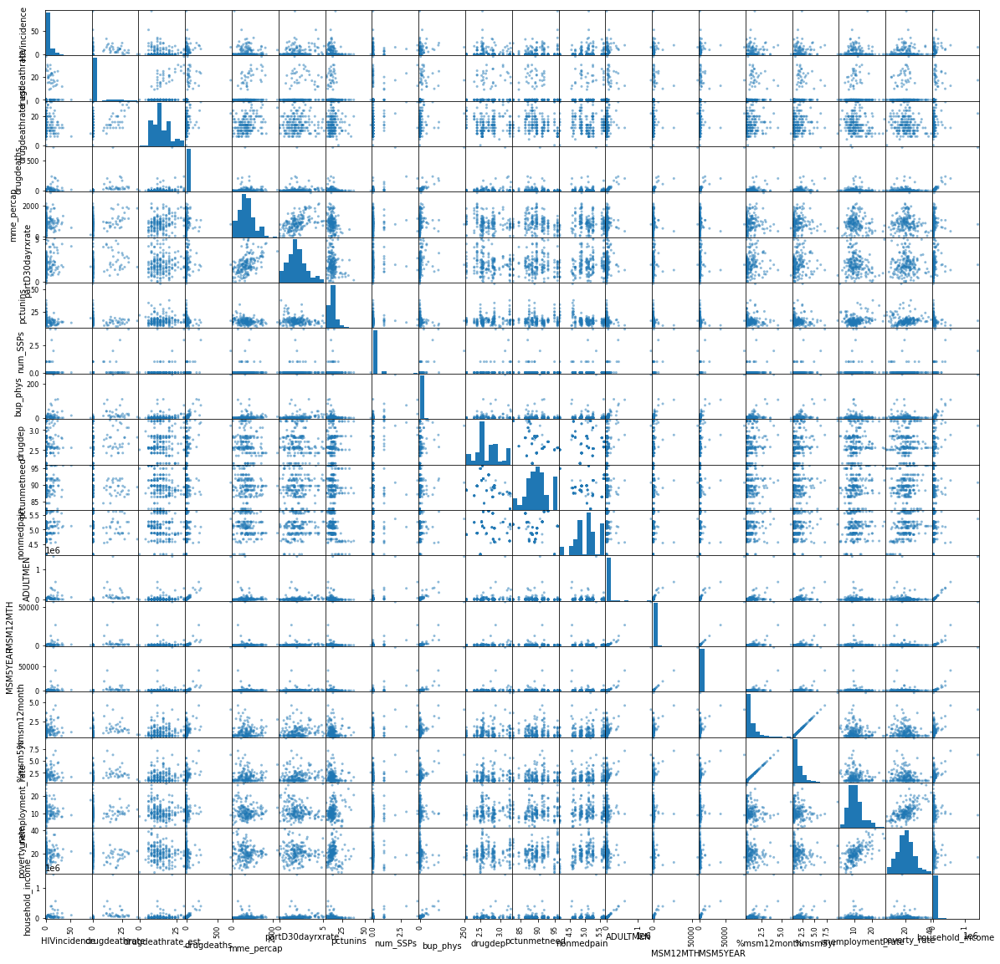

In [46]:
col_lst = ['HIVincidence', 'drugdeathrate', 'drugdeathrate_est', 'drugdeaths', 'mme_percap',
       'partD30dayrxrate', 'pctunins', 'num_SSPs', 'bup_phys', 'drugdep',
       'pctunmetneed', 'nonmedpain', 'ADULTMEN', 'MSM12MTH', 'MSM5YEAR',
       '%msm12month', '%msm5yr', 'unemployment_rate', 'poverty_rate',
       'household_income']
pd.plotting.scatter_matrix(df_main.loc[:200,col_lst] , figsize = (20,20));

In [7]:
df_main.iloc[:5,:16]

,Unnamed: 0,county_code,COUNTY,STATEABBREVIATION,YEAR,AMAT_fac,HIVdiagnoses,HIVincidence,HIVprevalence,MH_fac,Med_AMAT_fac,Med_MH_fac,Med_SA_fac,Med_SMAT_fac,Med_TMAT_fac,PLHIV
0,0,1001,Autauga County,AL,2015,0.0,5.0,10.9,225.5,1.0,0.0,1.0,2.0,0.0,0.0,103.0
1,1,1003,Baldwin County,AL,2015,0.0,15.0,8.7,163.9,4.0,0.0,3.0,1.0,0.0,0.0,282.0
2,2,1005,Barbour County,AL,2015,0.0,0.0,0.0,436.0,1.0,0.0,1.0,1.0,0.0,0.0,97.0
3,3,1007,Bibb County,AL,2015,0.0,0.0,0.0,191.9,0.0,0.0,0.0,1.0,1.0,0.0,37.0
4,4,1009,Blount County,AL,2015,0.0,5.0,10.4,95.4,1.0,0.0,1.0,1.0,0.0,0.0,46.0


HIVincidences - HIVprevelance (linear correlation)/100000, %MSM12, drugdep, unemployment_rate, household_income

In [26]:
df_main[df_main['drugdep'].isna()]

,Unnamed: 0,county_code,COUNTY,STATEABBREVIATION,YEAR,AMAT_fac,HIVdiagnoses,HIVincidence,HIVprevalence,MH_fac,...,pctunmetneed,nonmedpain,ADULTMEN,MSM12MTH,MSM5YEAR,%msm12month,%msm5yr,unemployment_rate,poverty_rate,household_income
547,547,15005,Kalawao County,HI,2015,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,34,0,0,0.0,0.0,0.0,17.6,46


In [27]:
df_main = df_main.drop(index = 547, axis = 1)

In [76]:
#simple_df = df_main[['HIVincidence', 'HIVprevalence', '%msm12month', 'drugdep', 'unemployment_rate', 'household_income']]
simple_df = df_main[['HIVincidence', 'household_income','HIVprevalence', 'HIVdiagnoses','%msm12month','drugdeaths','bup_phys']] #testing various columns
#simple_df.to_csv('../data/eda_init.csv')

In [93]:
simple_df = df_main[['HIVincidence', 'HIVprevalence', '%msm12month', 'bup_phys', 'drugdeaths']]

drop_idx = simple_df[simple_df['HIVincidence'] > 400].index
simple_df = simple_df.drop(index = drop_idx)
# simple_df.to_csv('../data/eda_init.csv')

In [95]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold, train_test_split
from sklearn.preprocessing import StandardScaler
import scipy.stats as scs
import sklearn.metrics as metrics

data = simple_df.drop(columns ='HIVincidence')
target = simple_df['HIVincidence']

X_train, X_test, Y_train, Y_test = train_test_split(data, target, test_size = 0.25)

kf = KFold(n_splits = 5)

mean_squared = []

for train, test in kf.split(X_train):
    x_train = data.iloc[train]
    y_train = target.iloc[train]
    x_test = data.iloc[test]
    y_test = target.iloc[test]
    
    X_scaler = StandardScaler()
#     y_scaler = StandardScaler()
    
    X_scaler.fit(x_train)
#     y_scaler.fit(y_train)
    
    x_train = X_scaler.transform(x_train)
    x_test = X_scaler.transform(x_test)
#     y_scaler.transform(y_train)
#     y_scaler.transform(y_test)
    lin_reg = LinearRegression()
    lin_reg.fit(x_train, y_train)
    
    y_hat = lin_reg.predict(x_test)
    mean_squared.append(metrics.mean_squared_error(y_test, y_hat))

In [96]:
mean_squared

[89.08720677493679,
 23.181806405370477,
 44.22900235537345,
 34.50890832659685,
 32.46135962675407]

In [97]:
X_test = X_scaler.transform(X_test)
dummy = lin_reg.predict(X_test)

In [98]:
metrics.mean_squared_error(Y_test, dummy)**.5

6.8766977063881995

In [99]:
lin_reg.coef_

array([ 5.91206501,  0.51665794, -0.74990201,  1.88288959])

In [100]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
def summary_model(X, y, label='scatter'):
    X = sm.add_constant(X)
    model = sm.OLS(y, X).fit()
    summary = model.summary()
    return summary

def plot_model(X, y, label='Residual Plot'):
    model = sm.OLS(y, X).fit()
    student_resids = model.outlier_test()['student_resid']
    y_hats = model.predict(X)

    plt.scatter(y_hats,student_resids, alpha = .35, label=label)
    plt.xlabel("Predicted y Values")
    plt.ylabel("Residuals (Difference between true and predict)")
    plt.legend()
    plt.show()

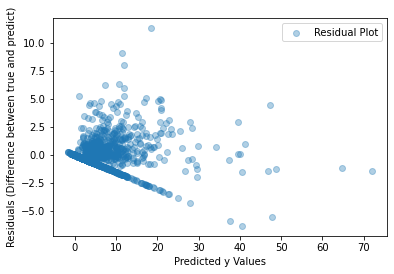

In [84]:
summary_model(X_train, Y_train)
plot_model(X_train, Y_train)

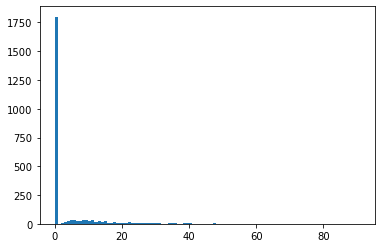

In [85]:
plt.hist(Y_train, bins = 100);

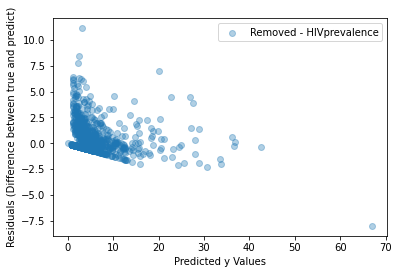

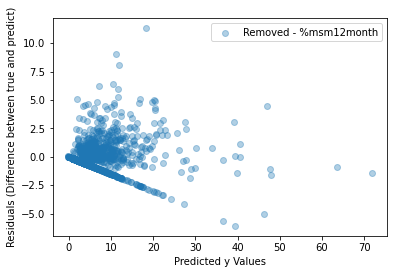

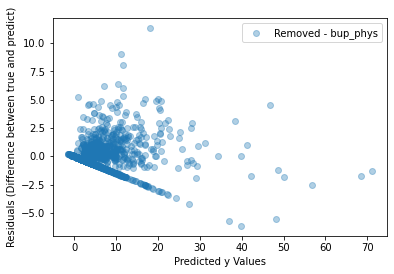

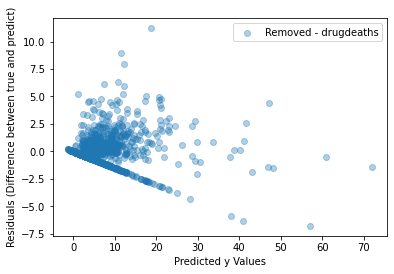

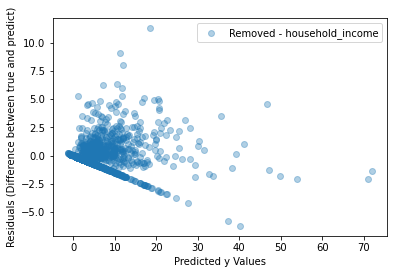

In [86]:
all_columns = X_train.columns
for col_name in all_columns:
    all_columns_copy = list(all_columns)
    all_columns_copy.remove(col_name)
    plot_model(X_train[all_columns_copy], Y_train, 'Removed - ' + str(col_name))

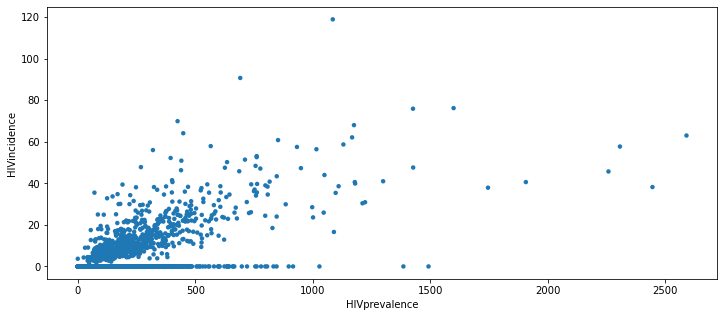

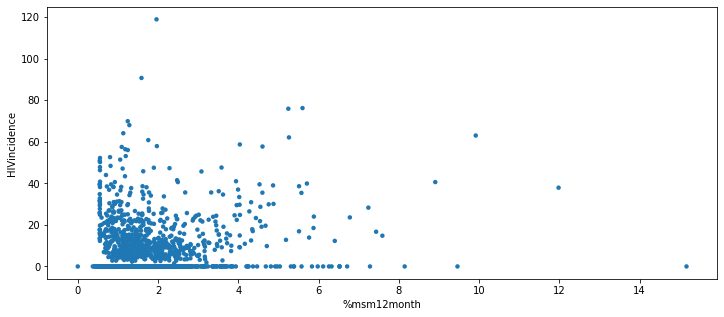

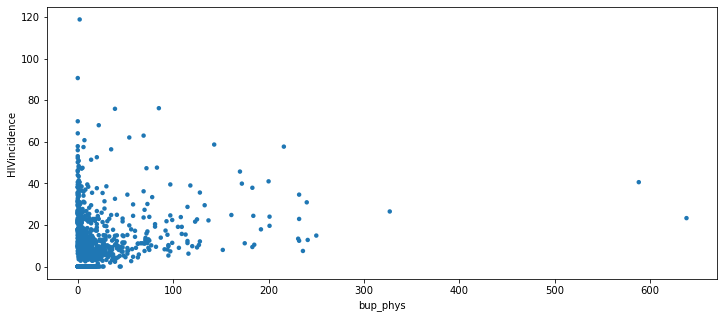

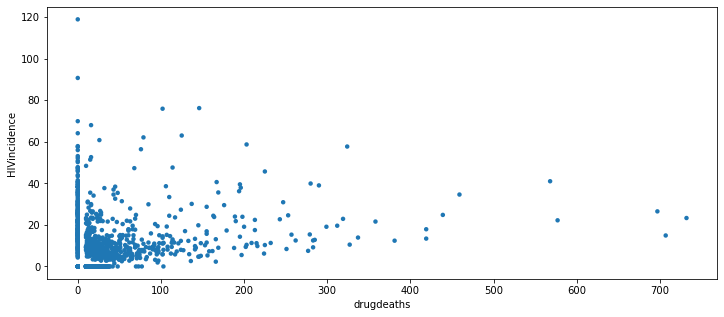

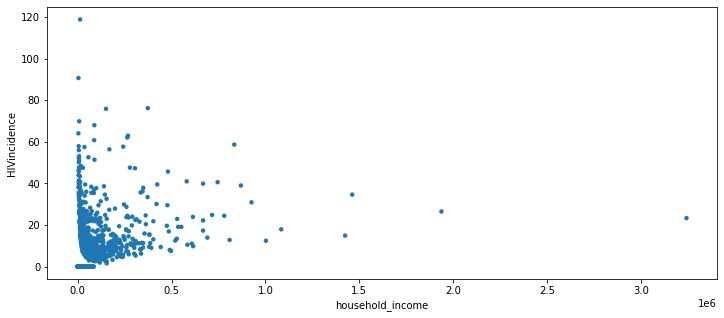

In [87]:
for col in all_columns:
    simple_df.plot(kind='scatter', y='HIVincidence', x=col, edgecolor='none', figsize=(12, 5))
    plt.xlabel(col)
    plt.ylabel('HIVincidence')
    plt.show()

In [89]:
metrics.r2_score(Y_test, dummy)

0.4933142669922683

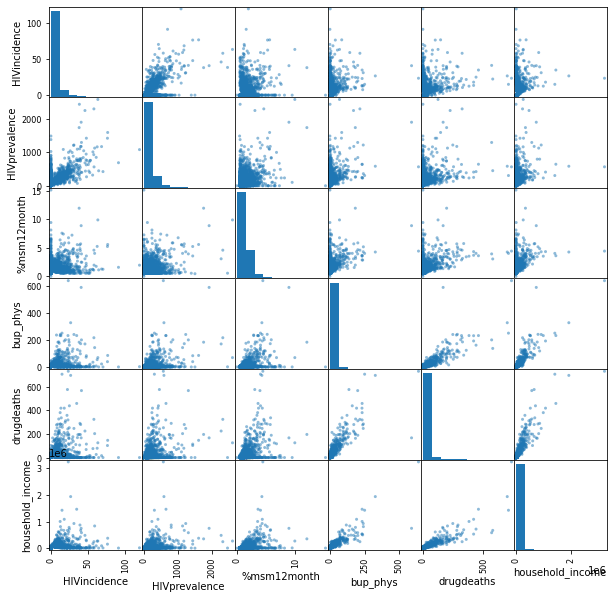

In [90]:
pd.plotting.scatter_matrix(simple_df, figsize=(10,10));

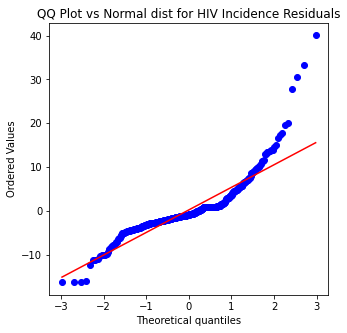

In [101]:
#QQ plot to show independence
fig, ax = plt.subplots(figsize=((5, 5)))
stats.probplot(y_test - y_hat, plot=ax);
ax.set_title("QQ Plot vs Normal dist for HIV Incidence Residuals");

plt.savefig('QQ2.png')

<class 'numpy.ndarray'> <class 'pandas.core.series.Series'>


'\nlinear_model = LinearRegression()\nlinear_model.fit(x.reshape(-1, 1), y)\n\ny_hat = linear_model.predict(x.reshape(-1, 1))\n\nfig, ax = plt.subplots(figsize=(14, 6))\nresidual_plot(ax, x, y, y_hat)\n'

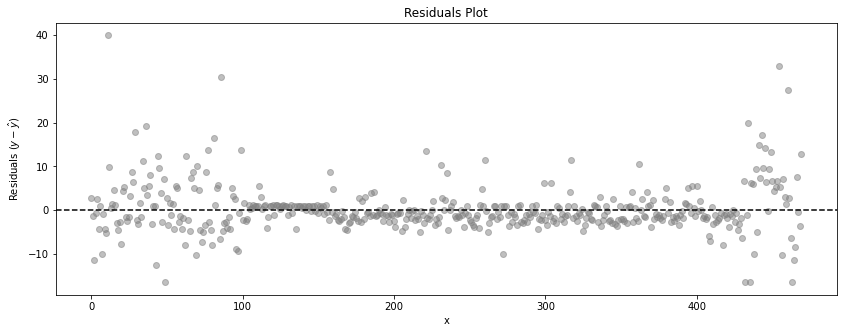

In [92]:
#plot residuals

residuals = y_test - y_hat

print(type(x_test),type(residuals))

fig, ax = plt.subplots(figsize=(14,5))

ax.axhline(0, color="black", linestyle="--")
ax.scatter(range(len(residuals)), residuals, color="grey", alpha=0.5)
ax.set_ylabel("Residuals ($y - \hat y$)")
ax.set_xlabel("x")
ax.set_title("Residuals Plot")

plt.savefig('residuals.png')

'''
linear_model = LinearRegression()
linear_model.fit(x.reshape(-1, 1), y)

y_hat = linear_model.predict(x.reshape(-1, 1))

fig, ax = plt.subplots(figsize=(14, 6))
residual_plot(ax, x, y, y_hat)
'''